In [ ]:
####################2. Enrich the rating dataset by outputing a new dataset that includes a RatingDateTime attribute

In [1]:
import numpy as np
import pandas as pd

In [2]:
ratings_data = pd.read_csv(r'C:\Users\Merit\Downloads\ml-latest-small\ml-latest-small\ratings.csv')
ratings_data.head()

,userId,movieId,rating,timestamp
0,1,1,4.0,964982703
1,1,3,4.0,964981247
2,1,6,4.0,964982224
3,1,47,5.0,964983815
4,1,50,5.0,964982931


In [3]:
ratings_data['RatingDate_Time'] = pd.to_datetime(ratings_data['timestamp'], unit= 's')
ratings_data

,userId,movieId,rating,timestamp,RatingDate_Time
0,1,1,4.0,964982703,2000-07-30 18:45:03
1,1,3,4.0,964981247,2000-07-30 18:20:47
2,1,6,4.0,964982224,2000-07-30 18:37:04
3,1,47,5.0,964983815,2000-07-30 19:03:35
4,1,50,5.0,964982931,2000-07-30 18:48:51
...,...,...,...,...,...
100831,610,166534,4.0,1493848402,2017-05-03 21:53:22
100832,610,168248,5.0,1493850091,2017-05-03 22:21:31
100833,610,168250,5.0,1494273047,2017-05-08 19:50:47
100834,610,168252,5.0,1493846352,2017-05-03 21:19:12


In [ ]:
######### 3.Output a dataset containing users that have rated a movie but not tagged 

In [4]:
ratings_data['userId']

0           1
1           1
2           1
3           1
4           1
         ... 
100831    610
100832    610
100833    610
100834    610
100835    610
Name: userId, Length: 100836, dtype: int64

In [5]:
tag_data = pd.read_csv(r'C:\Users\Merit\Downloads\ml-latest-small\ml-latest-small\tags.csv')
tag_data.head(100)

,userId,movieId,tag,timestamp
0,2,60756,funny,1445714994
1,2,60756,Highly quotable,1445714996
2,2,60756,will ferrell,1445714992
3,2,89774,Boxing story,1445715207
4,2,89774,MMA,1445715200
...,...,...,...,...
95,62,6541,captain nemo,1525554054
96,62,6541,comic book,1525554028
97,62,6541,gothic,1525554056
98,62,6541,Peta Wilson,1525554040


In [6]:
tag_data['userId']

0         2
1         2
2         2
3         2
4         2
       ... 
3678    606
3679    606
3680    610
3681    610
3682    610
Name: userId, Length: 3683, dtype: int64

In [7]:
#second question -ans
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format','{:.0f}'.format)
user_id=tag_data['userId'].subtract(ratings_data['userId'])
user_id

0          1
1          1
2          1
3          1
4          1
5          1
6          1
7          1
8          1
9          6
10        17
11        17
12        17
13        17
14        17
15        17
16        17
17        17
18        17
19        17
20        17
21        17
22        17
23        17
24        17
25        17
26        20
27        20
28        20
29        20
30        48
31        48
32        48
33        61
34        61
35        61
36        61
37        61
38        61
39        61
40        61
41        61
42        61
43        61
44        61
45        61
46        61
47        61
48        61
49        61
50        61
51        61
52        61
53        61
54        61
55        61
56        61
57        61
58        61
59        61
60        61
61        61
62        61
63        61
64        61
65        61
66        61
67        61
68        61
69        61
70        61
71        61
72        61
73        61
74        61
75        61
76        61

In [ ]:
######### 4.Min, max, and average rating per movie.

In [8]:
movie_data = pd.read_csv(r'C:\Users\Merit\Downloads\ml-latest-small\ml-latest-small\movies.csv')
movie_data.head()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [9]:
moving= pd.merge(ratings_data, movie_data, on='movieId')
moving.head()

,userId,movieId,rating,timestamp,RatingDate_Time,title,genres
0,1,1,4,964982703,2000-07-30 18:45:03,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,5,1,4,847434962,1996-11-08 06:36:02,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
2,7,1,4,1106635946,2005-01-25 06:52:26,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
3,15,1,2,1510577970,2017-11-13 12:59:30,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
4,17,1,4,1305696483,2011-05-18 05:28:03,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy


In [10]:
moving.groupby('title').rating.agg(['max', 'min','mean'])

,max,min,mean
title,,,
'71 (2014),4,4,4
'Hellboy': The Seeds of Creation (2004),4,4,4
'Round Midnight (1986),4,4,4
'Salem's Lot (2004),5,5,5
'Til There Was You (1997),5,3,4
'Tis the Season for Love (2015),2,2,2
"'burbs, The (1989)",5,1,3
'night Mother (1986),3,3,3
(500) Days of Summer (2009),5,0,4


In [ ]:
######### 5. Define a dataset that appends a year column to the movie dataset.

In [11]:
#### Append the year column


pattern = '\((\d{4})\)'
movie_data['year'] = movie_data.title.str.extract(pattern, expand=False)
movie_data

,movieId,title,genres,year
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995
1,2,Jumanji (1995),Adventure|Children|Fantasy,1995
2,3,Grumpier Old Men (1995),Comedy|Romance,1995
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,1995
4,5,Father of the Bride Part II (1995),Comedy,1995
5,6,Heat (1995),Action|Crime|Thriller,1995
6,7,Sabrina (1995),Comedy|Romance,1995
7,8,Tom and Huck (1995),Adventure|Children,1995
8,9,Sudden Death (1995),Action,1995
9,10,GoldenEye (1995),Action|Adventure|Thriller,1995


In [12]:
### Append movie name column

movie_data['movie_name'] = movie_data['title'].astype(str)


movie_data['movie_name'] = movie_data['title'].str.extract('([a-zA-Z ]+)', expand=False).str.strip()
movie_data

,movieId,title,genres,year,movie_name
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995,Toy Story
1,2,Jumanji (1995),Adventure|Children|Fantasy,1995,Jumanji
2,3,Grumpier Old Men (1995),Comedy|Romance,1995,Grumpier Old Men
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,1995,Waiting to Exhale
4,5,Father of the Bride Part II (1995),Comedy,1995,Father of the Bride Part II
5,6,Heat (1995),Action|Crime|Thriller,1995,Heat
6,7,Sabrina (1995),Comedy|Romance,1995,Sabrina
7,8,Tom and Huck (1995),Adventure|Children,1995,Tom and Huck
8,9,Sudden Death (1995),Action,1995,Sudden Death
9,10,GoldenEye (1995),Action|Adventure|Thriller,1995,GoldenEye


In [13]:
####  5.1 OUTPUT a dataset showing movies with the year appended
movie_data["Movie_year"] = movie_data["movie_name"] + movie_data["year"]
movie_data

,movieId,title,genres,year,movie_name,Movie_year
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995,Toy Story,Toy Story1995
1,2,Jumanji (1995),Adventure|Children|Fantasy,1995,Jumanji,Jumanji1995
2,3,Grumpier Old Men (1995),Comedy|Romance,1995,Grumpier Old Men,Grumpier Old Men1995
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,1995,Waiting to Exhale,Waiting to Exhale1995
4,5,Father of the Bride Part II (1995),Comedy,1995,Father of the Bride Part II,Father of the Bride Part II1995
5,6,Heat (1995),Action|Crime|Thriller,1995,Heat,Heat1995
6,7,Sabrina (1995),Comedy|Romance,1995,Sabrina,Sabrina1995
7,8,Tom and Huck (1995),Adventure|Children,1995,Tom and Huck,Tom and Huck1995
8,9,Sudden Death (1995),Action,1995,Sudden Death,Sudden Death1995
9,10,GoldenEye (1995),Action|Adventure|Thriller,1995,GoldenEye,GoldenEye1995


In [14]:
############5.2 OUTPUT the count of movies that don't have a year assigned

print(movie_data.year.isnull().sum())

13


In [15]:
###### 5.3 OUTPUT a dataset showing all movies that don't have a year assigned

mask = movie_data['year'].isnull() 
movie_data[mask]


,movieId,title,genres,year,movie_name,Movie_year
6059,40697,Babylon 5,Sci-Fi,NaN,Babylon,NaN
9031,140956,Ready Player One,Action|Sci-Fi|Thriller,NaN,Ready Player One,NaN
9091,143410,Hyena Road,(no genres listed),NaN,Hyena Road,NaN
9138,147250,The Adventures of Sherlock Holmes and Doctor W...,(no genres listed),NaN,The Adventures of Sherlock Holmes and Doctor W...,NaN
9179,149334,Nocturnal Animals,Drama|Thriller,NaN,Nocturnal Animals,NaN
9259,156605,Paterson,(no genres listed),NaN,Paterson,NaN
9367,162414,Moonlight,Drama,NaN,Moonlight,NaN
9448,167570,The OA,(no genres listed),NaN,The OA,NaN
9514,171495,Cosmos,(no genres listed),NaN,Cosmos,NaN
9515,171631,Maria Bamford: Old Baby,(no genres listed),NaN,Maria Bamford,NaN


In [16]:
###### 5.4 OUTPUT a dataset showing the 10 years with the most movies

tenyear = pd.DataFrame()
tenyear["year"]=movie_data['year'].astype(str).astype(float).nlargest(2000)

tenyear["mostmovies"]=movie_data['title']
pd.set_option('display.float_format','{:.0f}'.format)
tenyear

,year,mostmovies
8693,2018,Avengers: Infinity War - Part I (2018)
9668,2018,Annihilation (2018)
9674,2018,The Commuter (2018)
9678,2018,Insidious: The Last Key (2018)
9681,2018,Game Night (2018)
9682,2018,Maze Runner: The Death Cure (2018)
9683,2018,Isle of Dogs (2018)
9684,2018,The Clapper (2018)
9685,2018,Tom Segura: Disgraceful (2018)
9686,2018,When We First Met (2018)


In [17]:
############### 6 .Plot a data visualization for number of movies released by year and by genre.


import matplotlib.pyplot as plt
import warnings
import seaborn as sns
import numpy as np
warnings.filterwarnings("ignore")

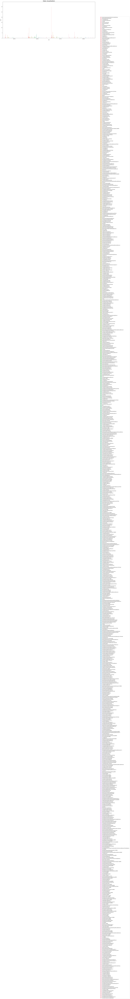

In [18]:
fig, axs = plt.subplots(nrows=1,figsize = (25,10)) #25,10
pd.set_option('display.float_format','{:.0f}'.format)
sns.countplot(x=movie_data['year'].astype(str).astype(float).nlargest(500), hue = "genres", data = movie_data, ax =axs)

axs.set_title("Data visualization", fontsize = 20)
axs.legend(loc='upper left',bbox_to_anchor = (1.05, 0.6))


plt.show()